In [2]:
#Ramiro A Merello
#OpenCV for Image Processing 
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import math

print(cv2.__version__)


3.4.2


In [3]:
###FUNCTIONS FOR PROYECT
"""
#This function converts the image, to a preprocessed binary image, returns
the final binary image processed, the eroded and the gray blured image
"""
THRESHOLD = 75
EROSION_ITER = 2
CLOSING_ITER = 10
def conv_binary_image(original_img):
    #Conver to gray scale 
    gray_scale = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)
    
    #Apply a medianBlur to remove popcornnoise and other unwanted details or specs in background
    gray_blur = cv2.medianBlur(gray_scale,7) 
    
    #Convert to binary imagy with threshold -> use THRESH_BINARY_INV for white background
    th,thresh = cv2.threshold(gray_blur, THRESHOLD, 255, cv2.THRESH_BINARY);
    
    kernel = np.ones((3, 3), np.uint8)  
    #Apply an erosoin first to avoid coins from merging from closing(dilation+erosion)
    erosion = cv2.erode(thresh, kernel, iterations = EROSION_ITER)
    #Apply Closing to help closing contours 
    bin_closing = cv2.morphologyEx(erosion, cv2.MORPH_CLOSE, kernel, iterations = CLOSING_ITER)
    
    return bin_closing, erosion, thresh, gray_blur

THRESHOLD_WHITE = 140
def conv_binary_image_whitebackground(original_img):
    #Conver to gray scale 
    gray_scale = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)
    
    #Apply a medianBlur to remove popcornnoise and other unwanted details or specs in background
    gray_blur = cv2.medianBlur(gray_scale,7) 
    
    #Convert to binary imagy with threshold -> use THRESH_BINARY_INV for white background
    th,thresh = cv2.threshold(gray_blur, THRESHOLD_WHITE, 255, cv2.THRESH_BINARY_INV);
    
    kernel = np.ones((3, 3), np.uint8)  
    #Apply an erosoin first to avoid coins from merging from closing(dilation+erosion)
    erosion = cv2.erode(thresh, kernel, iterations = EROSION_ITER)
    #Apply Closing to help closing contours 
    bin_closing = cv2.morphologyEx(erosion, cv2.MORPH_CLOSE, kernel, iterations = CLOSING_ITER)
    
    return bin_closing, erosion, thresh, gray_blur

"""
https://stackoverflow.com/questions/31998428/opencv-python-equalizehist-colored-image
+
https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_histograms/py_histogram_equalization/py_histogram_equalization.html
Equalices Histogram of image, will help with constrast of coin 
"""
def color_hist_equal(image):
    img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
    
    #img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0]) Standard equalize
    # create a CLAHE object (Arguments are optional).
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
     # equalize the histogram of the Y channel
    img_yuv[:,:,0] = clahe.apply(img_yuv[:,:,0])
    
    # convert the YUV image back to RGB format
    hist_equal_image = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)
    return hist_equal_image

"""
Rotate a point counterclockwise by a given angle around a given origin.
The angle should be given in radians.
Gracias Lucas y Pedro!
"""
def rotate(origin, point, angle):
    ox, oy = origin
    px, py = point
    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    return qx, qy

"""
A call to fitellipse in opencv will return the rotated rectangle which contains the elipse
This function will transform the elipse into a usuable set of points inside the image
"""
def transform_ellipse(ellipse):
    p1x, p1y = rotate(ellipse[0], (ellipse[0][0],ellipse[0][1]+ellipse[1][1]/2), ellipse[2]*np.pi/180)
    p2x, p2y = rotate(ellipse[0], (ellipse[0][0],ellipse[0][1]-ellipse[1][1]/2), ellipse[2]*np.pi/180)
    p3x, p3y = rotate(ellipse[0], (ellipse[0][0]+ellipse[1][0]/2,ellipse[0][1]), ellipse[2]*np.pi/180)
    p4x, p4y = rotate(ellipse[0], (ellipse[0][0]-ellipse[1][0]/2,ellipse[0][1]), ellipse[2]*np.pi/180)
    return  np.float32([[p1x,p1y], [p2x,p2y], [p3x,p3y], [p4x,p4y]])
    
HEIGHT_OUTPUT = 450
WIDTH_OUTPUT = 450
"""
This function recieves the image and a elipse surrounding a coin and returns the 
coin in a rectangle of WIDTH_OUTPUTxHEIGH_OUTPUT
"""
def transform_getcoin(image, ellipse):
    orig_pts = transform_ellipse(ellipse)
    #Transform to rectangle
    result_pts = np.float32([[0,HEIGHT_OUTPUT/2], [WIDTH_OUTPUT,HEIGHT_OUTPUT/2],
                             [WIDTH_OUTPUT/2,HEIGHT_OUTPUT], [WIDTH_OUTPUT/2,0]] ) 
    trans_matrix = cv2.getPerspectiveTransform(orig_pts, result_pts)
    result_image = cv2.warpPerspective(image, trans_matrix, (HEIGHT_OUTPUT, WIDTH_OUTPUT))    
    #Histogram Equalization to assure Contrast and be invarient towards the lighting
    # create a CLAHE object (Arguments are optional).-> Eqalization by sectors
    #clahe = cv2.createCLAHE(clipLimit = 2.0, tileGridSize = (8,8))
    #result_image = clahe.apply(result_image)
    return result_image

#DEFINES
CONT_MIN_POINTS = 10
CONT_MIN_AREA = 4000
CONT_MAX_AREA = 60000000
"""
This function recieves a binary and returns the contours fitted to ellipses,
min amount of points CONT_MIN_POINTS
min area of contour CONT_MIN_AREA
max area of contour CONT_MAX_AREA
"""
def get_ellipses_contours(binary_image):
    coins_contours = []
    #Find contours modifies source that is why a copy is passed
    #Returns Array of points in contours, image is the source modifies, hierachy is relation between contorurs
    image, contours, hierarchy = cv2.findContours(binary_image.copy(), cv2.RETR_EXTERNAL, 
                                                  cv2.CHAIN_APPROX_SIMPLE)
    for i in contours:
        if len(i) > CONT_MIN_POINTS:
            area = cv2.contourArea(i)
            if area > CONT_MIN_AREA and area < CONT_MAX_AREA:
                ellipse = cv2.fitEllipse(i)
                coins_contours.append(ellipse) #Add to list of coins
    return coins_contours


LUM_MIN = 40
LUM_MAX = 80
LUM_ADJ = 60
def adj_brightness_img(img):
    img_yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    y, u ,v = cv2.split(img_yuv)
    lumia_mean = cv2.mean(y)
    print(lumia_mean)
    if lumia_mean[0] < LUM_MIN:
        increase_value = LUM_ADJ - lumia_mean[0]
        increase_value = np.uint8(increase_value)
        increase_brightness(y, increase_value)
    elif lumia_mean[0] > LUM_MAX:
        decrease_value = lumia_mean[0] - LUM_MAX;
        decrease_value = np.uint8(decrease_value)
        decrease_brightness(y,decrease_value)
    
    final_yuv = cv2.merge((y, u, v))
    adj_img = cv2.cvtColor(final_yuv, cv2.COLOR_YUV2BGR)
    return adj_img

def increase_brightness(channel, value):
    lim = 255 - value
    channel[channel > lim] = 255
    channel[channel <= lim] += value
    return channel

def decrease_brightness(channel, value):
    lim = 0 + value
    channel[channel < lim] = 0
    channel[channel >= lim] -= value
    return channel

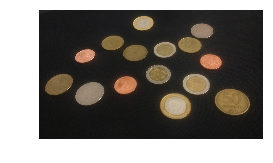

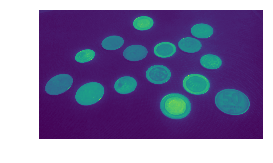

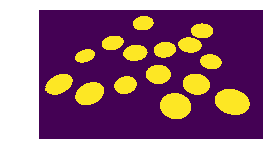

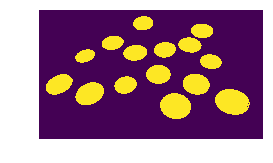

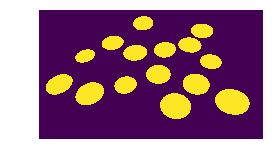

In [4]:
test_img = cv2.imread('imagenes_3//IMG_20181128_171725196.jpg')
test_img = cv2.cvtColor(test_img, cv2.COLOR_RGB2BGR)
original_img = test_img

bin_closing, erosion, thresh, gray_blur = conv_binary_image(test_img)

#Original Image
fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(original_img)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(gray_blur)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(thresh)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(erosion)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(bin_closing)





In [5]:
# coin_contours = get_ellipses_contours(bin_closing)
# coin_images = []

# for i in coin_contours:
#     coin_images.append(transform_getcoin(original_img, i)) #Get individual coins
#     cv2.ellipse(test_img, i, (0,255,0), 2) #Draw elipses 
    
# fig, ax = plt.subplots(figsize=(8, 6))
# ax.imshow(test_img) #Img with morders
# ax.axis('off')
    
# for i in coin_images:
#     fig, ax = plt.subplots(figsize=(8, 6))
#     ax.imshow(i)
#     ax.axis('off')
#     i = color_hist_equal(i)
#     fig, ax = plt.subplots(figsize=(8, 6))
#     ax.imshow(i)
#     ax.axis('off')




(46.26205080361018, 0.0, 0.0, 0.0)
(45.98233630574825, 0.0, 0.0, 0.0)
(68.07037474791687, 0.0, 0.0, 0.0)
(28.208137294069633, 0.0, 0.0, 0.0)
(47.147450830309076, 0.0, 0.0, 0.0)
(42.693309135697355, 0.0, 0.0, 0.0)
(57.60113903876759, 0.0, 0.0, 0.0)
(39.26932655479345, 0.0, 0.0, 0.0)
(37.464135470726234, 0.0, 0.0, 0.0)
(41.81919861172377, 0.0, 0.0, 0.0)
(87.86209143804132, 0.0, 0.0, 0.0)
(42.704537741464286, 0.0, 0.0, 0.0)
(26.14246640058163, 0.0, 0.0, 0.0)
(24.779252308787168, 0.0, 0.0, 0.0)
(27.890856004186617, 0.0, 0.0, 0.0)
(41.571309217356664, 0.0, 0.0, 0.0)
(38.81706584465227, 0.0, 0.0, 0.0)
(45.43022851815748, 0.0, 0.0, 0.0)
(45.30135971030421, 0.0, 0.0, 0.0)
(41.79333145862829, 0.0, 0.0, 0.0)
(39.77560803997951, 0.0, 0.0, 0.0)


C:\Users\Chewbacca\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(70.80290688216108, 0.0, 0.0, 0.0)
(45.120350074900976, 0.0, 0.0, 0.0)


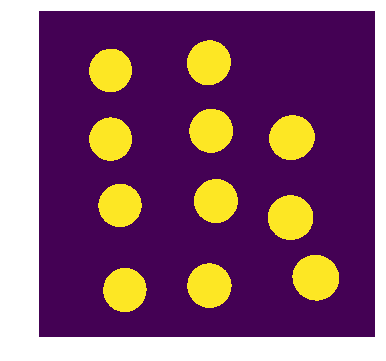

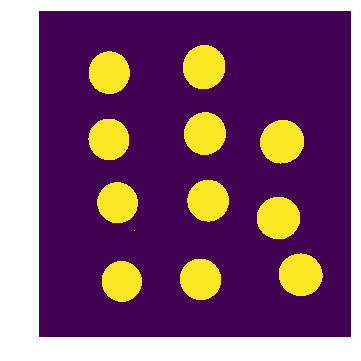

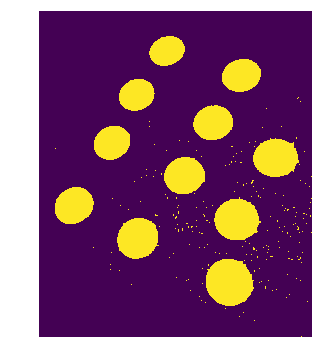

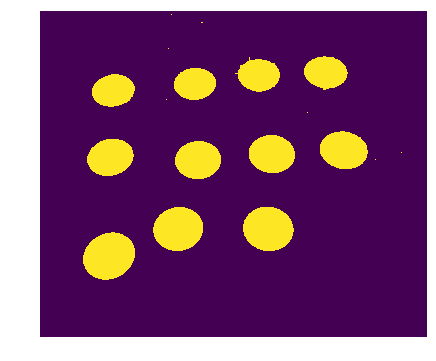

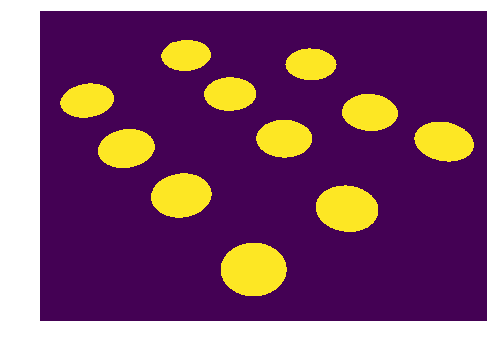

...

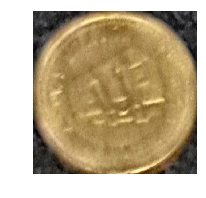

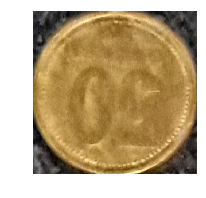

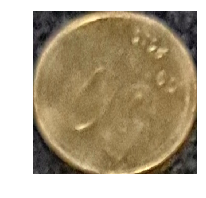

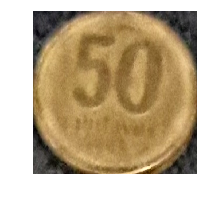

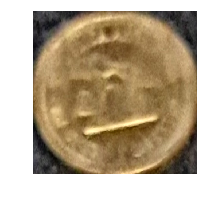

In [11]:
#Create data set for black background

"""
Returns 
    -Image_result: WILL MODIFY original image, will add coin contours 
    -coin_images[]: each individual coin. This have been histogram equalized to 
    improve constrast
"""
def get_all_coins(image):
    coin_contour = []
    coin_images = []
    
    image_result = image.copy()
    image_result = adj_brightness_img(image_result)
    bin_closing, erosion, thresh, gray_blur = conv_binary_image(image_result)

    coin_contours = get_ellipses_contours(bin_closing)
    for ellip_cont in coin_contours:
        coin_images.append(transform_getcoin(image_result, ellip_cont)) #Get individual coins
    for ellip_cont in coin_contours:
        cv2.ellipse(image, ellip_cont, (164,218,246), 8) #Draw elipses(miami blue) on image_result
   #Equalizes histogram per sector, gives the coin better contrast
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.axis('off')
    ax.imshow(bin_closing)
    for i in range(len(coin_images)):
        coin_images[i] = color_hist_equal( coin_images[i])
    return image, coin_images
   # return image_result, coin_images 


"""
Returns 
    -Image_result: WILL MODIFY original image, will add coin contours 
    -coin_images[]: each individual coin. This have been histogram equalized to 
    improve constrast
"""
def get_all_coins_whitebackground(image):
    coin_contour = []
    coin_images = []
    
    image_result = image.copy()
   # image_result = adj_brightness_img(image_result)
    bin_closing, erosion, thresh, gray_blur = conv_binary_image_whitebackground(image_result)
    bin_images.append(bin_closing)
    coin_contours = get_ellipses_contours(bin_closing)
    
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.axis('off')
    ax.imshow(bin_closing)
    
    for ellip_cont in coin_contours:
        coin_images.append(transform_getcoin(image_result, ellip_cont)) #Get individual coins
    for ellip_cont in coin_contours:
        cv2.ellipse(image, ellip_cont, (164,218,246), 8) #Draw elipses(miami blue) on image_result
   #Equalizes histogram per sector, gives the coin better contrast
    for i in range(len(coin_images)):
        coin_images[i] = color_hist_equal( coin_images[i])
    return image, coin_images
   # return image_result, coin_images 
import glob

images = [cv2.imread(file) for file in glob.glob('imagenes_3/rawdataset/mineblackbackground/monedaslimpias/50/*jpg')]
bin_images = []
coin_images = []
coin_images_temp = []


for i in range(len(images)):
    images[i] = cv2.cvtColor(images[i], cv2.COLOR_RGB2BGR)
    images[i], coin_images_temp = get_all_coins(images[i])
    coin_images.extend(coin_images_temp)


for i in range(len(images)):
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.axis('off')
    ax.imshow(images[i])

for i in range(len(coin_images)):
    filename = "imagenes_3/rawdataset/mineblackbackground/monedaslimpias/50separadas/moneda50_%d.jpg"%i
    cv2.imwrite(filename, cv2.cvtColor(coin_images[i], cv2.COLOR_BGR2RGB))
    fig, ax = plt.subplots(figsize=(3, 3))
    ax.imshow(coin_images[i])
    ax.axis('off')
    


In [15]:
#Create Data set https://gist.github.com/fchollet/0830affa1f7f19fd47b06d4cf89ed44d
#Base on https://github.com/amyoshino/Identifying-Brazilian-Coins-with-CNN/blob/master/Brazilian_coins_CNN.ipynb
#Keras 
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.models import model_from_json
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K
import os
import keras

# dimensions of our images.
img_width, img_height = 450, 450

train_data_dir = 'dataset/train'
test_data_dir = 'dataset/validation'
nb_train_samples = 110
nb_test_samples = 15
epochs = 50
batch_size = 16

if K.image_data_format() == 'channels_first':
    my_input_shape = (3, img_width, img_height)
else:
    my_input_shape = (img_width, img_height, 3)

# this is the augmentation configuration we will use for training
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

# this is the augmentation configuration we will use for testing:
test_datagen = ImageDataGenerator(rescale=1. / 255) # only rescaling

training_set = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='sparse')

test_set = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='sparse')



Found 440 images belonging to 4 classes.
Found 60 images belonging to 4 classes.


In [16]:
#Initializing CNN
classifier = Sequential()

# Creating Convolution layer
classifier.add(Conv2D(32, (5, 5), input_shape = my_input_shape, activation = 'relu'))

# Applying Pooling 
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a second convolutional layer
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a third convolutional layer
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a fourth convolutional layer
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding dropout
classifier.add(Dropout(0.2))

# Flattening
classifier.add(Flatten())

In [17]:
#Connecting everything and compiling!
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 5, activation = 'softmax'))

# Compiling the CNN
optimizer = keras.optimizers.Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
classifier.compile(optimizer = optimizer, loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])

In [18]:
classifier.fit_generator(training_set,
                         steps_per_epoch = 78,
                         epochs = 30,
                         validation_data = test_set,
                         validation_steps = 15)


Epoch 1/30
78/78 [==============================] - 543s 7s/step - loss: 1.2348 - acc: 0.4552 - val_loss: 1.2240 - val_acc: 0.4667
Epoch 2/30
78/78 [==============================] - 596s 8s/step - loss: 0.8791 - acc: 0.6194 - val_loss: 0.6174 - val_acc: 0.7333
Epoch 3/30
78/78 [==============================] - 624s 8s/step - loss: 0.6390 - acc: 0.7147 - val_loss: 0.5620 - val_acc: 0.7500
Epoch 4/30
78/78 [==============================] - 610s 8s/step - loss: 0.5240 - acc: 0.7765 - val_loss: 0.4166 - val_acc: 0.8167
Epoch 5/30
78/78 [==============================] - 610s 8s/step - loss: 0.4208 - acc: 0.8173 - val_loss: 0.3991 - val_acc: 0.8167
Epoch 6/30
78/78 [==============================] - 617s 8s/step - loss: 0.3236 - acc: 0.8686 - val_loss: 0.3411 - val_acc: 0.8167
Epoch 7/30
78/78 [==============================] - 612s 8s/step - loss: 0.3058 - acc: 0.8710 - val_loss: 0.3673 - val_acc: 0.8333
Epoch 8/30
78/78 [==============================] - 627s 8s/step - loss: 0.2941 - a

In [19]:
#Evaluating Model
classifier.evaluate_generator(test_set, steps = 32)

[0.1658226984164988, 0.9000000019868215]

In [31]:
# serialize model to JSON
model_json = classifier.to_json()
with open("model_final.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
classifier.save_weights("model_final.h5")
print("Saved model to disk")

Saved model to disk


In [34]:
#Available clases
print(training_set.class_indices)

{'moneda1': 0, 'moneda2': 1, 'moneda25': 2, 'moneda50': 3}


In [36]:
#Testing result
from keras.preprocessing import image
import numpy as np


test_image = image.load_img('1-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('1-2.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('25-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('2-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('50-4.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('2-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)






[0]
[0]
[0]
[1]
[3]
[1]
